# **Análisis Cluster**
El análisis cluster, o análisis de conglomerados, es una técnica estadística multivariante, cuyo objetivo es agrupar los elementos o variables análizadas en distintos grupos (clusters) en función de la homogeneidad existente entre ellas. 

El análisis cluster engloba distintos métodos, en nuestro ejemplo nos centraremos en el método K-means. El método **K-means** agrupa los elementos o variables analizadas en un número de clusters ya predeterminado. 

Para llevar a cabo nuestro ejemplo, escogeremos el dataset **VarCovid_provincias**, elaborado a partir de los datos publicados por el INE. 

Este dataset está compuesto por el número de fallecidos durante las semanas que duraron las respectivas olas, así como un promedio entre los años 2017, 2018 y 2019 del número de fallecidos en esas mismas semanas y la tasa de variación entre ambas para ver el exceso de muertes que se ha producido. Esta última variable será la que nosotros utilicemos en nuestro estudio.

Realizado por: Abel Carretero Novillo

## **K-means**

###**Carga de librerias y datos**
Cargamos las librerias que vamos a utilizar en el modelo.

In [61]:
# Preparación de los datos 
import numpy as np
import pandas as pd

# Modelado 
from sklearn.datasets import make_blobs
from sklearn.cluster import KMeans
from sklearn.preprocessing import scale

# Visualización
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Animación de gráficos
from IPython.display import Image
from matplotlib import animation


In [62]:
# Para poder visualizar nuestro gráfico rotatorio en 3D
# actualizar el SO e instalar el codec de imagenes
%%capture
!apt-get update
!apt install imagemagick

Subimos a Colab el archivo que vamos a utilizar, en nuestro caso es **VarCovid_provincias** 

In [63]:
from google.colab import files
uploaded = files.upload()

Saving VarCovid_provincias.xlsx to VarCovid_provincias (3).xlsx


Visualizamos los datos del archivo que acabamos de cargar.

In [64]:
datos=pd.read_excel('VarCovid_provincias.xlsx')
datos.head()

,provincia,falle_1Ola,falle1_med17_19,1Ola,falle_2Ola,falle2_med17_19,2Ola,falle_3Ola,falle3_med17_19,3Ola,falle_4Ola,falle4_med17_19,4Ola,falle_5Ola,falle5_med17_19,5Ola
0,Total nacional,113148,63962.333333,76.897862,157968,133844.666667,18.023380,135225,117257.5,15.323114,49445,47465.333333,4.170763,76307,64803.000000,17.752265
1,Albacete,1600,553.000000,189.330922,1287,1172.666667,9.749858,1186,1060.5,11.834041,395,409.333333,-3.501629,754,588.000000,28.231293
2,Alicante/Alacant,3011,2403.666667,25.266953,5852,5082.333333,15.143963,6474,4602.0,40.677966,1775,1781.666667,-0.374181,2961,2562.000000,15.573770
3,Almería,851,801.000000,6.242197,2003,1702.000000,17.685076,1936,1545.5,25.266904,665,605.666667,9.796368,1040,797.333333,30.434783
4,Araba/Alava,841,409.666667,105.288853,1022,934.666667,9.343795,763,729.0,4.663923,331,313.666667,5.526036,443,420.333333,5.392546


Creamos las diferentes variables que vamos a utilizar. En primer lugar vamos a llevar a cabo un análisis de las dos primeras olas, para ello, en la variable columnas, seleccionaremos la tasa de variación del exceso de mortalidad de la primera ola y segunda ola. Después, la lista que acabamos de crear, la convertimos en un DataFrame (resultado). Además, también tenemos nuestra serie con las provincias.

In [65]:
columnas = ["1Ola", "2Ola"]
resultado = datos[columnas]
provincias = datos["provincia"]


###**Método Elbow**
Para ver el número de cluster adecuado, aplicaremos el **método Elbow** o método del codo, en el cual medimos la distancia promedia de todos los puntos del cluster y su centroide, a través de la suma de sus cuadrados, con el objetivo de minimizar la varianza intra-cluster y maximizar de la varianza inter-cluster. 

Para calcularlo matemáticamente, nos situamos en el gráfico, donde tenemos en el eje x el número de cluster utilizados y en el eje y la suma de los cuadrados intra-cluster (dentro del cluster). Trazamos una línea entre los puntos calculados entre el primer y el último cluster, ese punto óptimo, en el que hay una mayor homogeneidad dentro del cluster y una mayor diferencia entre los cluster, es el punto más distante con la línea trazada. Dado que tenemos 53 variables, creemos conveniente encoger que los cluster se sitúen entre 1 y 10, ya que el punto más alejado se encontrará ahí, en 53 la distancia es 0. 

Para calcular la distancia de cada punto a la línea trazada se utiliza la siguiente fórmula:  

$$D[(P_0,P_1),(x,y)] = \frac{|(y_1-y_0)x-(x_1-x_0)y+x_1y_o-y_1x_0|}{\sqrt{(y_1-y_0)^2+(x_1-x_0)^2}}$$  

Para calcularlo en nuestro código, utilizaremos nuestra lista inercia[ ],que contiene la suma de cuadrados dentro de los cluster y nos delvolverá el número optimo de cluster.


El número óptimo de clusters es:  4 



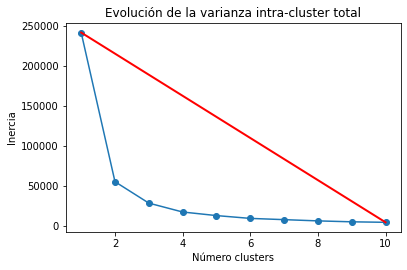

In [66]:
range_clusters = range(1, 11)
inercia = []

for i in range_clusters:
    modelo = KMeans(
                        n_clusters   = i, 
                        n_init       = 20, 
                        random_state = 50
                     )
    modelo.fit(resultado)
    inercia.append(modelo.inertia_)

fig, ax = plt.subplots(1, 1, figsize=(6, 3.84))
ax.plot(range_clusters, inercia, marker='o')
ax.set_title("Evolución de la varianza intra-cluster total")
ax.set_xlabel('Número clusters')
ax.set_ylabel('Inercia')

# Trazamos la línea
x0, y0 = 1, inercia[0]
x1, y1 = 10, inercia[len(inercia)-1]
ax.plot([x0, x1], [y0, y1], color='red', linewidth=2)

# Determinamos las distancias desde cada punto x, y a la recta P_0-P_1
distancias = []
for i in range(len(inercia)):
  x = i+2
  y = inercia[i]
  numerador = abs((y1-y0)*x - (x1-x0)*y + x1*y0 - y1*x0)
  denominador = np.sqrt((y1 - y0)**2 + (x1 - x0)**2)
  distancias.append(numerador/denominador)
print('\nEl número óptimo de clusters es: ', distancias.index(max(distancias)) + 2, '\n')

Vamos a escalar el modelo, ya que hay grandes diferencias entre las tasas de la primera y segunda ola, así tendremos nuestros datos dentro de un rango dado, como posteriormente veremos gráficamente. Además, creamos los **cluster**, en nuestro caso vamos a escoger 4 cluster. En este caso utilizamos fit() para ajustar el modelo a los datos que hemos cargado y el método predict() para realizar predicciones. 

In [67]:
resultado_escalado = scale(resultado)
modelo = KMeans(n_clusters=4)
modelo.fit(resultado_escalado)
grupos = modelo.predict(resultado_escalado)

Una vez creados los cluster, los relacionamos con nuestra variable provincias que contiene todas las provincias de España. 

In [68]:
clusters=pd.concat([provincias,pd.DataFrame(grupos)],axis=1)
clusters.rename(columns={"provincia":"Provincias",0:"Cluster"},inplace=True)
clusters

,Provincias,Cluster
0,Total nacional,1
1,Albacete,3
2,Alicante/Alacant,0
3,Almería,1
4,Araba/Alava,0
5,Asturias,1
6,Avila,0
7,Badajoz,1
8,"Balears, Illes",0
9,Barcelona,3


### **Representación gráfica**
Vamos a visualizar nuestro modelo, para ello, definimos la función que vamos a llevar a cabo, en este caso situación. En nuestro gráfico de dispersión tendremos dos parametros, x e y, que serán los datos escogidos, c que es el color que le vamos a dar a los datos y s el tamaño de la forma en la que se presenta el dato (marker). 

Además, introducimos unos centroides que se situaran en el centro de cada cluster. 

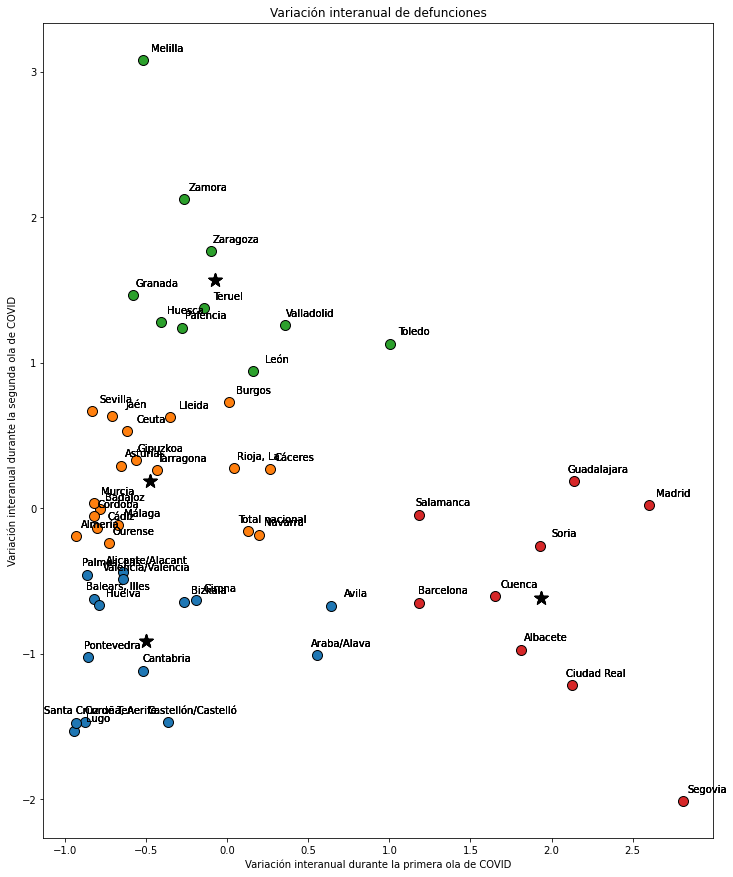

In [69]:
def situacion (x, y, z):
  fig, ax = plt.subplots()
  for i in np.unique(grupos):
    ax.scatter(
        x = resultado_escalado[grupos == i, 0],
        y = resultado_escalado[grupos == i, 1], 
        c = plt.rcParams['axes.prop_cycle'].by_key()['color'][i],
        s=100,
        marker    = 'o',
        edgecolor = 'black', 
        label= f'Cluster {i}'
    )
    for i in range(53):       
       ax.text(x[i]+0.15,y[i]+0.08, z[i], color = 'black', ha = 'center', va = 'center')
    ax.set_title('Variación interanual de defunciones')
    ax.set_xlabel('Variación interanual durante la primera ola de COVID')
    ax.set_ylabel('Variación interanual durante la segunda ola de COVID')
    ax.scatter(
    x = modelo.cluster_centers_[:,0],
    y = modelo.cluster_centers_[:,1], 
    c = 'black',
    s = 200,
    marker = '*',
    label  = 'centroides'
  )
  fig.set_figheight(15)
  fig.set_figwidth(12)
  fig.show()
situacion(resultado_escalado[:,0],resultado_escalado[:,1],provincias)

Viendo los resultados podemos establecer algunas conclusiones, por ejemplo, la primera ola afecto especialmente a provincias como Segovia, Madrid o Ciudad Real, sin embargo, el impacto de la segunda ola fue mucho menor. Al contrario de lo que courre en provincias como Melilla, Granada o Sevilla, donde el impacto de la segunda ola fue mayor que el de la primera, es decir, hubo un mayor exceso de muertes. Además, entre provincias de una misma Comunidad Autonoma también hay diferencias, son los casos de Ciudad Real y Toledo o Valladolid y Segovia. Por último, el gráfico muestra que el exceso de muertes no viene marcado por el número de habitantes, ya que vemos resultados similares entre provincias como Madrid y Soria o entre Barcelona y Ávila.

### **Representación tridimensional**
Ahora vamos a introducir una nueva variable y son los datos de la tasa de variación de la tercera ola.

In [70]:
datos=pd.read_excel('VarCovid_provincias.xlsx')
datos.head()

,provincia,falle_1Ola,falle1_med17_19,1Ola,falle_2Ola,falle2_med17_19,2Ola,falle_3Ola,falle3_med17_19,3Ola,falle_4Ola,falle4_med17_19,4Ola,falle_5Ola,falle5_med17_19,5Ola
0,Total nacional,113148,63962.333333,76.897862,157968,133844.666667,18.023380,135225,117257.5,15.323114,49445,47465.333333,4.170763,76307,64803.000000,17.752265
1,Albacete,1600,553.000000,189.330922,1287,1172.666667,9.749858,1186,1060.5,11.834041,395,409.333333,-3.501629,754,588.000000,28.231293
2,Alicante/Alacant,3011,2403.666667,25.266953,5852,5082.333333,15.143963,6474,4602.0,40.677966,1775,1781.666667,-0.374181,2961,2562.000000,15.573770
3,Almería,851,801.000000,6.242197,2003,1702.000000,17.685076,1936,1545.5,25.266904,665,605.666667,9.796368,1040,797.333333,30.434783
4,Araba/Alava,841,409.666667,105.288853,1022,934.666667,9.343795,763,729.0,4.663923,331,313.666667,5.526036,443,420.333333,5.392546


In [71]:
columnas = ["1Ola", "2Ola","3Ola"]
resultado = datos[columnas]
provincias = datos["provincia"]

Para visualizar nuestra 3 variables, vamos a introducir una serie de cambios. En este caso volvemos a escalar el modelo para que nuestros resultados se enmarquen dentro de un rango. La C corresponderan a los centroides del modelo y le asignamos colores a nuestros 4 clusters. 
Para poder visualizar nuestras 3 variables lo haremos a través de un gráfico tridimensional, para ello necesitamos cargar Axes3D, trazaremos nuestros puntos y le aplicamos la función de rotación para oder visualizar mejor los puntos en los 3 ejes.

In [72]:
# Eliminamos la salida gráfica de esta celda de codigo
# para que nos salga un gráfico estático duplicado
%%capture

# Escalar y estimar el modelo 
resultado_escalado = scale(resultado)
modelo = KMeans(n_clusters=4)
modelo.fit(resultado_escalado)
labels = modelo.predict(resultado_escalado)

# Centroides
C = modelo.cluster_centers_

# Asignar colores a los clusters
colores=['red','green','blue','orange']
asignar=[]
for row in labels:
    asignar.append(colores[row])

# Crear elemento de visualización
fig = plt.figure()
ax = Axes3D(fig)
ax.set_title('Variación interanual de defunciones')
ax.set_xlabel('Primera ola de COVID')
ax.set_ylabel('Segunda ola de COVID')
ax.set_zlabel('Tercera ola de COVID')

# Trazar y anotar punto a punto
for i in range(len(resultado_escalado)): 
  x = resultado_escalado[i,0]
  y = resultado_escalado[i,1]
  z = resultado_escalado[i,2]
  label = provincias[i]
  ax.scatter(x, y, z, color=asignar[i])
  ax.text(x, y , z, 
          '%s' % (label), 
          size=10, 
          zorder=1, 
          color=asignar[i], 
          alpha=.75)

# Añadimos los centroides 
ax.scatter(C[:, 0], C[:, 1], C[:, 2], marker='*', c=colores, s=100)

fig.set_figheight(8)
fig.set_figwidth(10)

# Le aplicamos la rotación
def rotar(angulo):
    ax.view_init(azim=angulo)

rotacion= animation.FuncAnimation(fig, rotar, frames=np.arange(0,360,2),interval=100)

rotacion.save('rotation.gif', dpi=80, writer='imagemagick')


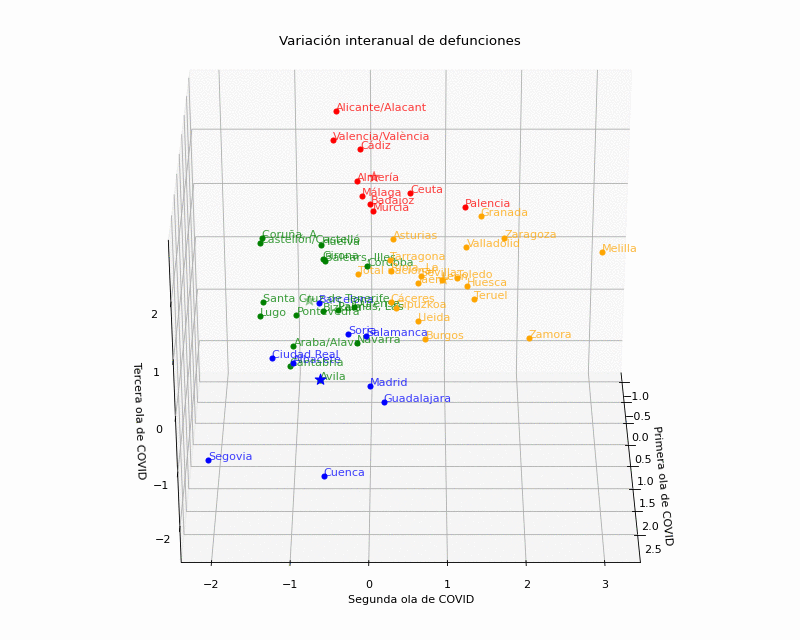

In [73]:
# Abrir gráfico animado
Image(open('/content/rotation.gif', 'rb').read())

Mostramos la posición de los centroides para comprender mejor como se agrupan las CCAA en los clusters.

In [74]:
centroides = pd.DataFrame(C, columns=['Primera ola', 'Segunda ola', 'Tercera ola'], index=range(4))
centroides.index.name = "Cluster"
centroides

,Primera ola,Segunda ola,Tercera ola
Cluster,,,
0,-0.690027,0.048042,1.489283
1,-0.475097,-0.828427,-0.652394
2,1.936252,-0.615502,-0.240903
3,-0.190235,0.966419,-0.041953


In [75]:
clusters=pd.concat([provincias,pd.DataFrame(labels)],axis=1)
clusters.rename(columns={"provincia":"Provincias",0:"Cluster"},inplace=True)
clusters

,Provincias,Cluster
0,Total nacional,3
1,Albacete,2
2,Alicante/Alacant,0
3,Almería,0
4,Araba/Alava,1
5,Asturias,3
6,Avila,1
7,Badajoz,0
8,"Balears, Illes",1
9,Barcelona,2


Con los centroides, podemos observar una imagen media del cluster, a pesar que dentro de él pueden haber grandes divergencias, dado el número de provincias que se analiza. A pesar de ello, podemos extraer que el centroide del cluster 0 presenta un mayor peso de la tercera ola, en cambio, el cluster 1 lo hace de la primera ola y el cluster 3 de la segunda, donde el déficit por defunciones es más representativo.

### **Otras olas**
Ahora vamos a llevar a cabo un análisis de la 3º y 5º Ola, para ello cargamos de nuevo los datos y asignamos variables. 

In [76]:
datos=pd.read_excel('VarCovid_provincias.xlsx')
datos.head()

,provincia,falle_1Ola,falle1_med17_19,1Ola,falle_2Ola,falle2_med17_19,2Ola,falle_3Ola,falle3_med17_19,3Ola,falle_4Ola,falle4_med17_19,4Ola,falle_5Ola,falle5_med17_19,5Ola
0,Total nacional,113148,63962.333333,76.897862,157968,133844.666667,18.023380,135225,117257.5,15.323114,49445,47465.333333,4.170763,76307,64803.000000,17.752265
1,Albacete,1600,553.000000,189.330922,1287,1172.666667,9.749858,1186,1060.5,11.834041,395,409.333333,-3.501629,754,588.000000,28.231293
2,Alicante/Alacant,3011,2403.666667,25.266953,5852,5082.333333,15.143963,6474,4602.0,40.677966,1775,1781.666667,-0.374181,2961,2562.000000,15.573770
3,Almería,851,801.000000,6.242197,2003,1702.000000,17.685076,1936,1545.5,25.266904,665,605.666667,9.796368,1040,797.333333,30.434783
4,Araba/Alava,841,409.666667,105.288853,1022,934.666667,9.343795,763,729.0,4.663923,331,313.666667,5.526036,443,420.333333,5.392546


In [77]:
columnas = ["3Ola", "5Ola"]
resultado = datos[columnas]
provincias = datos["provincia"]

#### **Representación gráfica**

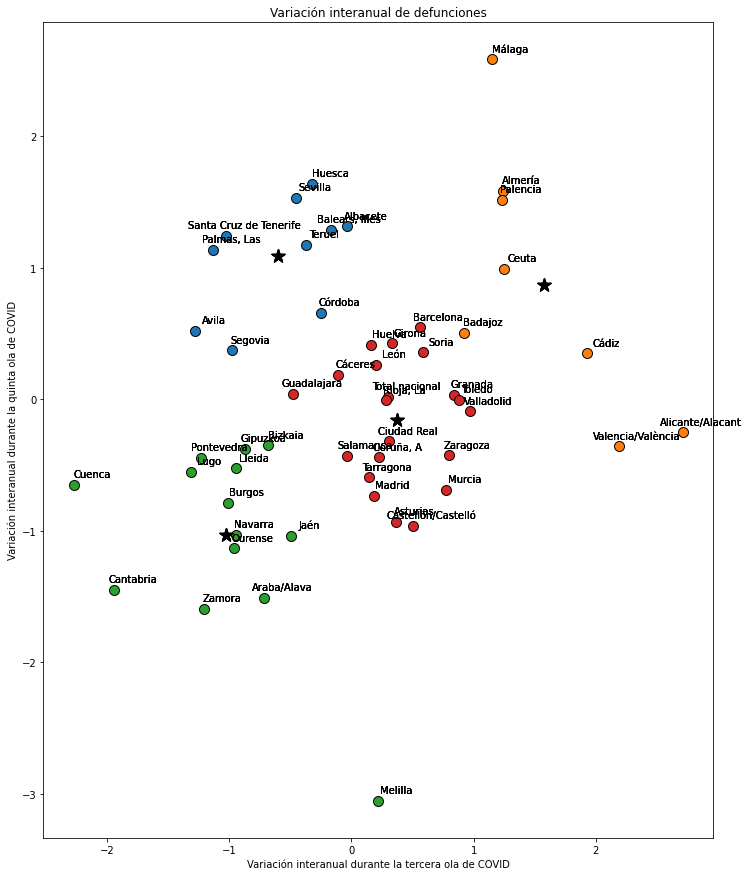

In [78]:
resultado_escalado = scale(resultado)
modelo = KMeans(n_clusters=4)
modelo.fit(resultado_escalado)
grupos = modelo.predict(resultado_escalado)
def situacion (x, y, z):
  fig, ax = plt.subplots()
  for i in np.unique(grupos):
    ax.scatter(
        x = resultado_escalado[grupos == i, 0],
        y = resultado_escalado[grupos == i, 1], 
        c = plt.rcParams['axes.prop_cycle'].by_key()['color'][i],
        s=100,
        marker    = 'o',
        edgecolor = 'black', 
        label= f'Cluster {i}'
    )
    for i in range(53):       
       ax.text(x[i]+0.15,y[i]+0.08, z[i], color = 'black', ha = 'center', va = 'center')
    ax.set_title('Variación interanual de defunciones')
    ax.set_xlabel('Variación interanual durante la tercera ola de COVID')
    ax.set_ylabel('Variación interanual durante la quinta ola de COVID')
    ax.scatter(
    x = modelo.cluster_centers_[:,0],
    y = modelo.cluster_centers_[:,1], 
    c = 'black',
    s = 200,
    marker = '*',
    label  = 'centroides'
  )
  fig.set_figheight(15)
  fig.set_figwidth(12)
  fig.show()
situacion(resultado_escalado[:,0],resultado_escalado[:,1],provincias)

Teniendo en cuenta los resultados del gráfico, así como los datos descargados del INE, podemos establecer que se produce la gran concentración de variables en el centro del gráfico se debe a una mayor homogeneización de los resultados en lo que concierne a la quinta ola, ya que la mayoria de provincias presenta un exceso de mortalidad entre el 15 y el 30%. Sin embargo, hay algunas excepciones, es el caso de Melilla, donde inluso se registra un menor número de defunciones con respecto al promedio de ese mismo periodo en los años 2017, 2018 y 2019. Al contrario que ocurre en Malaga, donde se produce el mayor excendente. 
Algo similar ocurre en la tercera ola, donde las provincias de la Comunidad Valenciana, como Valencia y Alicante, sufren los mayores excesos y Cuenca y Cantabria las mayores disminuciones, situandose por debajo de promedio. 
Fijandonos en los cluster, podemos observar que en cluster rojo presenta el menor exceso, seguido del cluster verde y azul, donde cada uno presenta un mayor exceso en una ola diferente, y, por último, el cluster naranja, que es el que presenta un mayor exceso teniendo en cuenta ambas olas. 